In [1]:
%load_ext autoreload
%autoreload 2

import sys
sys.path.append("../")

from pathlib import Path
import plotly.express as px
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import kaleido

import src.data_loading as data_loading
import src.make_features as make_features



In [2]:
RAW_DATA_FOLDER = Path("../data/raw")

GAS_AND_HEAT_FOLDER = RAW_DATA_FOLDER.joinpath("Data gas and heat - new")

building_names = [
    '10.10-PF1',
    '10.25-PF1',
    '10.26-TF1',
    '10.28-PF1',
    '10.33-PF1',
    '10.4-TF1',
    # '10.6-PF1',
    '10.6-PF2',
    '10.9.2-PF1',
    '2.2-PF1',
    '2.3.-PF1',
    '2.7-PF1',
    '2.8.-PF1',
    '2.9-PF1',
    '22.3-PF1'
]
all_buildings_metadata_df = data_loading.get_building_metadata_df(data_folder=RAW_DATA_FOLDER,
                                                                  building_list=building_names)

all_buildings_diff_df = pd.read_parquet("../data/processed/all_buildings_cleaned_diff_kwh.parquet")


In [3]:
all_buildings_metadata_df

,Building,Address,Use Type,Addr meter,Energy,Unit,Heat,measurement interval,Note,Data for DKSR,...,Floors below ground,Number of classrooms,Number of gyms,Number of kitchen,Building height (m),Year of construction,Materials,Heat insulation,Windows,Windows area (m2)
0,ZŠ Brigádníků,"Brigádníků 510/14, 100 00 Praha 10",School,10.26/PF1,gas,"m3, Nm3",Heat,1h,Delete!!,NO,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,ZŠ Brigádníků,"Brigádníků 510/14, 100 00 Praha 10",School,10.26/TF1,heat,GJ,Heat,2 per day,NaN,YES,...,1.0,25.0,2.0,1.0,measurement app,1960.0,NaN,NO,The vertical windows are made of plastic. The ...,NaN
2,ZŠ Gutova,"Gutova 1987/39, 100 00 Praha 10",School,10.28/PF1,gas,"m3, Nm3",Heat,1h,NaN,YES,...,1.0,25.0,2.0,1.0,measurement app,1970.0,reinforced concrete 240 mm,NO,NaN,NaN
3,MŠ Chmelová,"Podléškova 3087/26, 100 00 Praha 10",School,10.9.2/PF1,gas,"m3, Nm3",Heat,24h,NaN,YES,...,NaN,NaN,NaN,NaN,measurement app,NaN,NaN,NaN,NaN,NaN
4,MŠ Kodaňská,"Kodaňská 14/989, 101 00 Praha 10",School,10.10/PF1,gas,"m3, Nm3",Heat,1h,NaN,YES,...,NaN,NaN,NaN,NaN,measurement app,NaN,NaN,NaN,NaN,NaN
5,ZŠ Karla Čapka,"Kodaňská 658/16, Praha 10 - Vršovice",School,10.25/PF1,gas,"m3, Nm3",Heat,1h,NaN,YES,...,1.0,31.0,NaN,1.0,measurement app,1915.0,NaN,NO,NaN,NaN
6,ZŠ U Vršovického nádraží,"U vršovického nádraží 950/1, Praha 10 - Vršovice",School,10.33/PF1,gas,"m3, Nm3",Heat,1h,NaN,YES,...,1.0,19.0,1.0,1.0,measurement app,1930.0,NaN,NO,The vertical windows are made of plastic. The ...,NaN
7,ZŠ Švehlova,Švehlova 2900/ 12\n106 00 Praha 10-Záběhlice,School,10.4/PF1,gas,"m3, Nm3",Heat,1h,Pouze kuchyně!!!,NaN,...,NaN,NaN,NaN,NaN,measurement app,NaN,NaN,NaN,NaN,NaN
8,ZŠ Švehlova,"Švehlova 2900/ 12, 106 00 Praha 10-Záběhlice",School,10.4/TF1,heat,GJ,Heat,2 per day,NaN,YES,...,1.0,1.0,2.0,1.0,measurement app,1970.0,NaN,Roof - YES,The vertical windows are made of plastic. The ...,NaN
9,Areál Gutova,Gutova 1987/39,Sport areal,10.6/PF1,gas,"m3, Nm3",Heat,1h,Delete!!,NO,...,NaN,NaN,NaN,NaN,measurement app,NaN,NaN,NaN,NaN,NaN


In [4]:
all_buildings_metadata_df[['Addr meter','Heating output - numeric']]

,Addr meter,Heating output - numeric
0,10.26/PF1,NaN
1,10.26/TF1,NaN
2,10.28/PF1,NaN
3,10.9.2/PF1,NaN
4,10.10/PF1,NaN
5,10.25/PF1,NaN
6,10.33/PF1,NaN
7,10.4/PF1,NaN
8,10.4/TF1,NaN
9,10.6/PF1,NaN


In [5]:
x = pd.DataFrame(all_buildings_diff_df['2.8.-PF1']/2740*100)
x['2.9-PF1'] = all_buildings_diff_df['2.9-PF1']/1404.6*100
x['2.7-PF1'] = all_buildings_diff_df['2.7-PF1']/500*100
x['22.3-PF1'] = all_buildings_diff_df['22.3-PF1']/2000*100
x['2.2-PF1']= all_buildings_diff_df['2.2-PF1']/430*100
x['2.3.-PF1'] = all_buildings_diff_df['2.3.-PF1']/1200*100

full_time_range = pd.date_range(start='2021-01-01', end='2024-12-31 23:00:00', freq='H', tz='UTC')

x = x.clip(upper=100)
x = x.reindex(full_time_range)
x

/tmp/ipykernel_65666/2378082728.py:8: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  full_time_range = pd.date_range(start='2021-01-01', end='2024-12-31 23:00:00', freq='H', tz='UTC')


,2.8.-PF1,2.9-PF1,2.7-PF1,22.3-PF1,2.2-PF1,2.3.-PF1
2021-01-01 00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN
2021-01-01 01:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN
2021-01-01 02:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN
2021-01-01 03:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN
2021-01-01 04:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...
2024-12-31 19:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN
2024-12-31 20:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN
2024-12-31 21:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN
2024-12-31 22:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
build_2_8 = x.sort_values(by='2.8.-PF1')
utilization = pd.DataFrame(columns=['2021','2022','2023'])
utilization['2021'] = x['2.8.-PF1'][:'2021-12-31 23:00:00+00:00'].reset_index(drop=True).sort_values(ascending=False).reset_index(drop=True)
utilization['2022'] = x['2.8.-PF1']['2022-01-01 00:00:00+00:00':'2022-12-31 23:00:00+00:00'].reset_index(drop=True).sort_values(ascending=False).reset_index(drop=True)
utilization['2023'] = x['2.8.-PF1']['2023-01-01 00:00:00+00:00':'2023-12-31 23:00:00+00:00'].reset_index(drop=True).sort_values(ascending=False).reset_index(drop=True)

In [41]:
fig = px.line(utilization, 
             #names=uses.index, 
             #values=uses["count"], 
             width=1400, height=600,
             title="Yearly Boiler utilization at DS Malešice",
             template="plotly_white")
fig.update_layout(showlegend=True,
                  title_x = 0.5,
                  xaxis_title="Number of days",
                  yaxis_title="Utilization %")

fig.write_image("../reports/Boiler_yearly.png")
fig.show()
#px.line(utilization, line_shape='spline')


In [8]:
px.line(utilization)

In [17]:
build = pd.DataFrame(columns= x.columns)
build ['2.2-PF1'] = x['2.2-PF1'][:'2021-12-31 23:00:00+00:00'].reset_index(drop=True).sort_values(ascending=False).reset_index(drop=True)
build ['2.3.-PF1'] = x['2.3.-PF1'][:'2021-12-31 23:00:00+00:00'].reset_index(drop=True).sort_values(ascending=False).reset_index(drop=True)
build ['22.3-PF1'] = x['22.3-PF1'][:'2021-12-31 23:00:00+00:00'].reset_index(drop=True).sort_values(ascending=False).reset_index(drop=True)
build ['2.7-PF1'] = x['2.7-PF1'][:'2021-12-31 23:00:00+00:00'].reset_index(drop=True).sort_values(ascending=False).reset_index(drop=True)
build ['2.9-PF1'] = x['2.9-PF1'][:'2021-12-31 23:00:00+00:00'].reset_index(drop=True).sort_values(ascending=False).reset_index(drop=True)
build ['2.8.-PF1'] = x['2.8.-PF1'][:'2021-12-31 23:00:00+00:00'].reset_index(drop=True).sort_values(ascending=False).reset_index(drop=True)
px.line(build)

In [23]:
build = pd.DataFrame()
build ['Gymnázium Na Vítězné pláni'] = x['2.2-PF1'][:'2021-12-31 23:00:00+00:00'].reset_index(drop=True).sort_values(ascending=False).reset_index(drop=True)
build ['Gymnázium a Hudební škola hlavního města Prahy'] = x['2.3.-PF1'][:'2021-12-31 23:00:00+00:00'].reset_index(drop=True).sort_values(ascending=False).reset_index(drop=True)
build ['Obecní dům'] = x['22.3-PF1'][:'2021-12-31 23:00:00+00:00'].reset_index(drop=True).sort_values(ascending=False).reset_index(drop=True)
build ['DS Elišky Purkyňové'] = x['2.7-PF1'][:'2021-12-31 23:00:00+00:00'].reset_index(drop=True).sort_values(ascending=False).reset_index(drop=True)
build ['DS Chodov'] = x['2.9-PF1'][:'2021-12-31 23:00:00+00:00'].reset_index(drop=True).sort_values(ascending=False).reset_index(drop=True)
build ['DS Malešice'] = x['2.8.-PF1'][:'2021-12-31 23:00:00+00:00'].reset_index(drop=True).sort_values(ascending=False).reset_index(drop=True)
px.line(build)

In [38]:
fig = px.line(build, 
             #names=uses.index, 
             #values=uses["count"], 
             width=1400, height=600,
             title="2021 Boiler utilization",
             template="plotly_white")
fig.update_layout(title_x = 0.5,
                  xaxis_title="Number of days",
                  yaxis_title="Utilization %",
                  showlegend = True,
                  )

fig.write_image("../reports/Boiler_buildings_2021.png")
fig.show()
#px.line(utilization, line_shape='spline')


In [11]:
x.to_csv('../data/processed/capacity.csv')

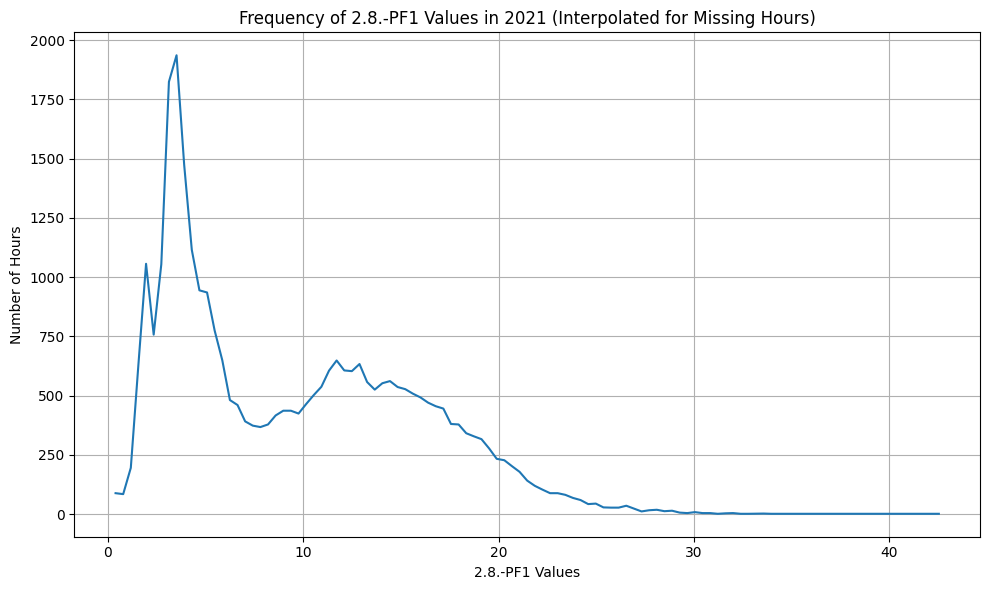

In [12]:
# Group by the values of '2.8.-PF1' and count how many hours had each value
value_counts_full = x['2.8.-PF1'].value_counts().sort_index()

# Plot the value frequency with swapped axes
plt.figure(figsize=(10, 6))
plt.plot(value_counts_full.index, value_counts_full.values,label='Frequency of 2.8.-PF1')

plt.title('Frequency of 2.8.-PF1 Values in 2021 (Interpolated for Missing Hours)')
plt.xlabel('2.8.-PF1 Values')
plt.ylabel('Number of Hours')
plt.grid(True)
plt.tight_layout()

# Display the plot
plt.show()


In [13]:
px.line(x)

In [14]:
px.line(x['2.3.-PF1'][:'2021-12-31 23:00:00+00:00'])